##### Importing the Libraries and defining the helper functions

In [2]:
# importing the libraries
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

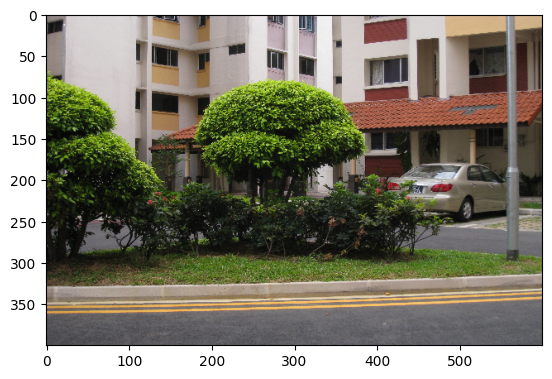

In [4]:
# function to open and image and resize it
def open_resize(img, w, h):
    image = cv2.imread(img) # read the image
    image = cv2.resize(image, (w, h)) # resize the image
    return image # return the image

# function to display an image
def show_image(img, w=0, h=0, axis=False, title=''):
    if w == 0 or h == 0: plt.figure()
    else: plt.figure(figsize=(w, h)) # set the size of the figure
    plt.title(title) # set the title of the figure
    plt.imshow(img) # show the image
    if axis == False: plt.axis('off') # turn off the axis
    plt.show() # show the image    

# function to convert BGR to RGB
def BGR2RGB(img):
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # convert the image from BGR to RGB

#### TEST THE FUNCTIONS ####
test = open_resize('Dataset/scene1/I11.jpg', 600, 400)
show_image(BGR2RGB(test), axis=True)

### `Step 1` Detect, extract, and match features

Using SIFT detector to detect the features, and Brute-Force matcher to match the features. The result is shown below.

In [5]:
# function to get the keypoints and descriptors
def get_keypoints_descriptors(img):
    sift = cv2.SIFT_create() # create a SIFT object
    kp, des = sift.detectAndCompute(img, None) # get the keypoints and descriptors
    des = des.astype(np.uint8)
    return kp, des # return the keypoints and descriptors

# function to draw the keypoints
def draw_keypoints(img, kp):
    return cv2.drawKeypoints(img, kp, None) # draw the keypoints

# functio to get the src and dst points
def get_src_dst_points(image1, image2):
    gray1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY) # convert the image to grayscale
    gray2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY) # convert the image to grayscale
    keypoints1, descriptors1 = get_keypoints_descriptors(gray1) # get the keypoints and descriptors
    keypoints2, descriptors2 = get_keypoints_descriptors(gray2) # get the keypoints and descriptors
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True) # create a BFMatcher object
    matches = bf.match(descriptors1, descriptors2) # get the matches
    matches = sorted(matches, key=lambda x: x.distance) # sort the matches
    # Draw the matches between the 2 images
    matching_result = cv2.drawMatches(image1, keypoints1, image2, keypoints2, matches, outImg=None)
    # get the coordinates of the matched points
    src_pts = np.float32([keypoints1[m.queryIdx].pt for m in matches]).reshape(-1, 2)
    dst_pts = np.float32([keypoints2[m.trainIdx].pt for m in matches]).reshape(-1, 2)
    return src_pts, dst_pts, matching_result # return the src and dst points and the matching result    

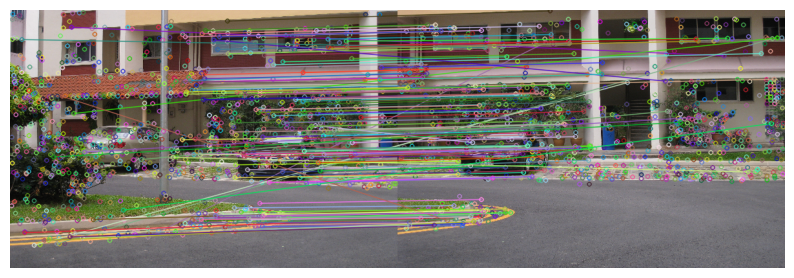

In [6]:
#### TEST THE FUNCTIONS ####
image1 = open_resize('Dataset/scene1/I12.jpg', 600, 400)
image2 = open_resize('Dataset/scene1/I13.jpg', 600, 400)
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
show_image(BGR2RGB(matching_result), w=10, h=5)

### `Step 2` Estimate homography matrix between two images using RANSAC.

Given the source points and destination points compute_homography() function computes the homography matrix. The best homography matrix is selected by RANSAC algorithm, implemented as ransac_homography() function. The result is shown below.

In [7]:
# function to compute the homography
def compute_homography(src_pts, dst_pts): 
    num_points = src_pts.shape[0] # get the number of points
    A_matrix = [] # matrix A for homography calculation
    for i in range(num_points):
        src_x, src_y = src_pts[i, 0], src_pts[i, 1]
        dst_x, dst_y = dst_pts[i, 0], dst_pts[i, 1]
        # Constructing the rows of the A matrix
        A_matrix.append([src_x, src_y, 1, 0, 0, 0, -dst_x * src_x, -dst_x * src_y, -dst_x])
        A_matrix.append([0, 0, 0, src_x, src_y, 1, -dst_y * src_x, -dst_y * src_y, -dst_y])
    A_matrix = np.asarray(A_matrix) # convert the matrix to numpy array
    U, S, Vh = np.linalg.svd(A_matrix) # perform SVD
    L = Vh[-1, :] / Vh[-1, -1] # calculate the homography
    H = L.reshape(3, 3) # reshape the homography
    return H # return the homography

In [8]:
#### TEST THE FUNCTION ####
image1 = open_resize('Dataset/scene1/I11.jpg', 600, 400)
image2 = open_resize('Dataset/scene1/I12.jpg', 600, 400)
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
idx = np.random.choice(src_pts.shape[0], 4, replace=False) 
H = compute_homography(src_pts[idx], dst_pts[idx]) 
print('Homography Matrix:')
print(H)

Homography Matrix:
[[ 3.91213361e-01 -1.56540855e-01 -7.96598341e+01]
 [-1.76497515e-01  3.67446603e-01  9.76646463e+01]
 [-7.92663451e-04 -7.74891393e-04  1.00000000e+00]]


In [9]:
# RANSAC to find the best homography matrix
def ransac_homography(src_pts, dst_pts, n_iter=1000, threshold=0.5):
    n = src_pts.shape[0] # get the number of points
    best_H = None # initialize the best homography matrix
    max_inliers = 0 # initialize the maximum number of inliers
    for i in range(n_iter):
        idx = np.random.choice(n, 4, replace=False) # randomly select 4 points
        H = compute_homography(src_pts[idx], dst_pts[idx]) # compute the homography matrix
        src_pts_hat = np.hstack((src_pts, np.ones((n, 1)))) # convert to homogeneous coordinates
        dst_pts_hat = np.hstack((dst_pts, np.ones((n, 1)))) # convert to homogeneous coordinates
        dst_pts_hat_hat = np.matmul(H, src_pts_hat.T).T # apply the homography matrix
        dst_pts_hat_hat = dst_pts_hat_hat[:, :2] / dst_pts_hat_hat[:, 2:] # convert back to non-homogeneous coordinates
        diff = np.linalg.norm(dst_pts_hat_hat - dst_pts, axis=1) # compute the difference between the predicted and actual coordinates
        inliers = np.sum(diff < threshold) # count the number of inliers
        if inliers > max_inliers: # update the best homography matrix
            max_inliers = inliers 
            best_H = H
    return best_H # return the best homography matrix

In [10]:
#### TEST THE FUNCTION ####
image1 = open_resize('Dataset/scene1/I12.jpg', 600, 400)
image2 = open_resize('Dataset/scene1/I13.jpg', 600, 400)
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
best_H = ransac_homography(src_pts, dst_pts, n_iter=10000, threshold=0.5)
print('Best Homography Matrix:')
print(best_H)

Best Homography Matrix:
[[ 1.10942139e+00  1.24788612e-03 -2.86918367e+02]
 [ 1.51381324e-02  1.07799975e+00 -1.47459874e+01]
 [ 1.83085652e-04 -3.87132426e-06  1.00000000e+00]]


### `Step 3` Stitch color images of each scene from the dataset using the homography matrix estimated in step (2) to create a panorama.

##### Defining the helper functions for stitching

In [14]:
# function to align the images
def align_images(image, H, factor):
    h, w, _ = image.shape # get the shape of image
    _h, _w = factor*h, factor*w  # create a canvas that is 4 times larger than image
    aligned_image = np.zeros((_h, _w, 3), dtype=np.uint8) # initialize the output image

    # Loop through each pixel in the output image
    for y in range(-h, _h-h):
        for x in range(-w, _w-w):
            # Apply the homography transformation to find the corresponding pixel in image
            pt = np.dot(H, np.array([x, y, 1]))
            pt = pt / pt[2]  # Normalize the coordinates
            # Check if the transformed coordinates are within the bounds of image
            if 0 <= pt[0] < image.shape[1] and 0 <= pt[1] < image.shape[0]:
                # Interpolate the pixel color value using bilinear interpolation
                x0, y0 = int(pt[0]), int(pt[1])
                x1, y1 = x0 + 1, y0 + 1
                alpha = pt[0] - x0
                beta = pt[1] - y0
                # Check if the neighboring pixels are within the bounds of image
                if 0 <= x0 < image.shape[1] and 0 <= x1 < image.shape[1] and \
                   0 <= y0 < image.shape[0] and 0 <= y1 < image.shape[0]:
                    # Bilinear interpolation
                    interpolated_color = (1 - alpha) * (1 - beta) * image[y0, x0] + \
                                         alpha * (1 - beta) * image[y0, x1] + \
                                         (1 - alpha) * beta * image[y1, x0] + \
                                         alpha * beta * image[y1, x1]
                    aligned_image[y+h, x+w] = interpolated_color.astype(np.uint8)  # Set the pixel value in the canvas as transformed pixel value         
    return aligned_image, h, w # return the aligned image and canvas parameters

# function to remove the black background
def remove_black_background(img):
    mask = img.sum(axis=2) > 0 # create a mask to remove black pixels
    y, x = np.where(mask) # get the coordinates of the non-black pixels
    x_min, x_max = x.min(), x.max() # get the minimum and maximum x coordinates
    y_min, y_max = y.min(), y.max() # get the minimum and maximum y coordinates
    img = img[y_min:y_max+1, x_min:x_max+1, :] # crop the image
    return img # return the image

# function to align the images
def get_transformed_images(img1, img2, H, focus=2, blend=True, factor=4, b_region=5):
    h1, w1 = img1.shape[:2] # height and width of the first image
    h2, w2 = img2.shape[:2] # height and width of the second image
    corners1 = np.array([[0, 0], [0, h1], [w1, h1], [w1, 0]], dtype=np.float32) # corners of the first image
    corners2 = np.array([[0, 0], [0, h2], [w2, h2], [w2, 0]], dtype=np.float32) # corners of the second image
   
    # coordinates of the four corners of the transformed image
    corners2_transformed = cv2.perspectiveTransform(corners2.reshape(1, -1, 2), H).reshape(-1, 2)
    # coordinates of the four corners of the new image
    corners = np.concatenate((corners1, corners2_transformed), axis=0)
    x_min, y_min = np.int32(corners.min(axis=0).ravel() - 0.5)
    x_max, y_max = np.int32(corners.max(axis=0).ravel() + 0.5)
    
    T = np.array([[1, 0, -x_min], [0, 1, -y_min], [0, 0, 1]]) # translation matrix
    H_inv = np.linalg.inv(T.dot(H)) # inverse of the homography matrix

    if focus == 1: # wrap the second image into the first image
        img_transformed, h_, w_ = align_images(img2, H, factor) # align the second image
        img_res = img_transformed.copy() # copy the transformed image
        img_res[h_ : h1 + h_, w_ : w1 + w_] = img1 # paste the first image

        if blend == True: # blend around the edges
            img_reg = img_res[h_ : h_ + h1 , -b_region + w_ : w_ + b_region] # right edge
            img_res[h_:h_+h1 , -b_region + w_ : w_ + b_region] = cv2.GaussianBlur(img_reg, (3, 1), b_region, b_region)
            img_reg = img_res[h_ : h_ + h1 , w2 - b_region + w_ : w_ + b_region + w2] # left edge
            img_res[h_ : h_ + h1 , w2 - b_region + w_ : w_ + b_region + w2] =  cv2.GaussianBlur(img_reg, (3, 1), b_region, b_region)
            img_reg = img_res[-b_region + h_ : h_ + b_region , w_ : w_ + w1] # top edge
            img_res[-b_region + h_ : h_ + b_region , w_ : w_ + w1] =  cv2.GaussianBlur(img_reg, (1, 3), b_region, b_region)
            img_reg = img_res[h2 - b_region + h_ : h_ + b_region  + h2, + w_ : w_ + w1] # bottom edge
            img_res[h2 - b_region + h_ : h_ + b_region  + h2, w_ : w_ + w1] =  cv2.GaussianBlur(img_reg, (1, 3), b_region, b_region)

    else: # wrap the first image into the second image
        img_transformed, h_, w_ = align_images(img1, H_inv, factor) # align the first image
        img_res = img_transformed.copy()  # copy the transformed image        
        img_res[-y_min + h_ : h2 - y_min + h_, -x_min + w_ : w2 - x_min + w_] = img2 # paste the second image  
        
        if blend == True: # blend around the edges
            img_reg = img_res[-y_min + h_ : h_ + h2 - y_min, -x_min - b_region + w_ : w_ + b_region - x_min] # right edge
            img_res[-y_min + h_:h_+h2 - y_min, -x_min -b_region+ w_:w_+b_region - x_min] = cv2.GaussianBlur(img_reg, (3, 1), b_region, b_region)
            img_reg = img_res[-y_min + h_ : h_ + h2 - y_min, -x_min + w2 - b_region+  w_ : w_ + b_region - x_min + w2] # left edge
            img_res[-y_min + h_ : h_ + h2 - y_min, - x_min + w2 - b_region+ w_ : w_ + b_region - x_min + w2] =  cv2.GaussianBlur(img_reg, (3, 1), b_region, b_region)
            img_reg = img_res[-y_min - b_region + h_ : h_ + b_region - y_min, -x_min + w_ : w_ + w2 - x_min] # top edge
            img_res[-y_min - b_region + h_ : h_ + b_region - y_min, - x_min + w_ : w_ + w2 - x_min] =  cv2.GaussianBlur(img_reg, (1, 3), b_region, b_region)
            img_reg = img_res[-y_min + h2 - b_region + h_ : h_ + b_region - y_min + h2, - x_min + w_ : w_ + w2 - x_min] # bottom edge
            img_res[-y_min + h2 - b_region + h_ : h_ + b_region - y_min + h2, -x_min + w_ : w_ + w2 - x_min] =  cv2.GaussianBlur(img_reg, (1, 3), b_region, b_region)

    return img_res # return the transformed image

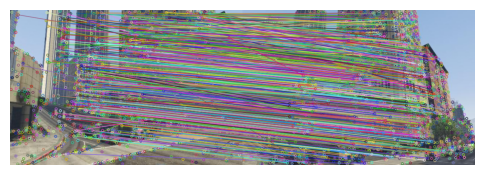

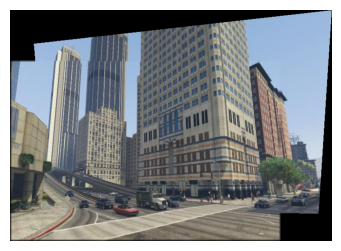

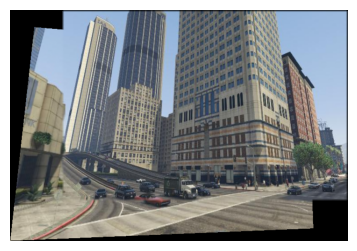

In [24]:
#### TEST THE FUNCTIONS ####
image1 = open_resize('Dataset/scene4/I41.jpg', 600, 400)
image2 = open_resize('Dataset/scene4/I42.jpg', 600, 400)
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
show_image(BGR2RGB(matching_result), w=6, h=3)
best_H = ransac_homography(src_pts, dst_pts, n_iter=1000, threshold=0.5)

aligned_image_1 = get_transformed_images(image1, image2, best_H, focus=1)
aligned_image_1 = remove_black_background(BGR2RGB(aligned_image_1))
show_image(aligned_image_1, w=6, h=3)

aligned_image_2 = get_transformed_images(image1, image2, best_H, focus=2)
aligned_image_2 = remove_black_background(BGR2RGB(aligned_image_2))
show_image(aligned_image_2, w=6, h=3)

#### Scene 1

In [55]:
# creating folder for scene1
if not os.path.exists('Results/scene1'):
    os.makedirs('Results/scene1')

# operning the images
image1 = open_resize('Dataset/scene1/I11.jpg', 600, 400)
image2 = open_resize('Dataset/scene1/I12.jpg', 600, 400)
image3 = open_resize('Dataset/scene1/I13.jpg', 600, 400)
image4 = open_resize('Dataset/scene1/I14.jpg', 600, 400)

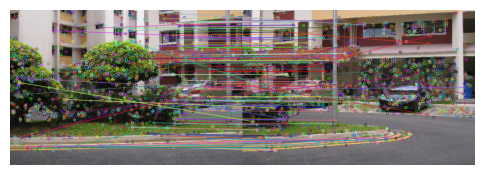

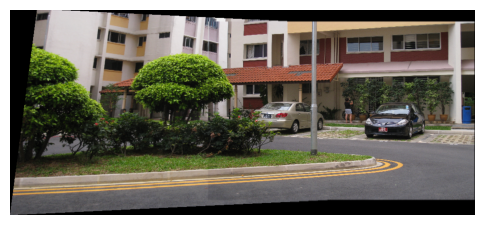

In [58]:
# stitiching image1 and image2
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
show_image(BGR2RGB(matching_result), w=6, h=3)
best_H = ransac_homography(src_pts, dst_pts, n_iter=10000, threshold=5)
aligned_image_1 = get_transformed_images(image1, image2, best_H, focus=2, blend=True)
aligned_image_1 = remove_black_background(BGR2RGB(aligned_image_1))
show_image(aligned_image_1, w=6, h=3)

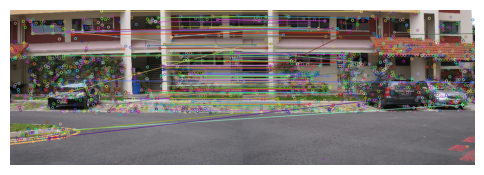

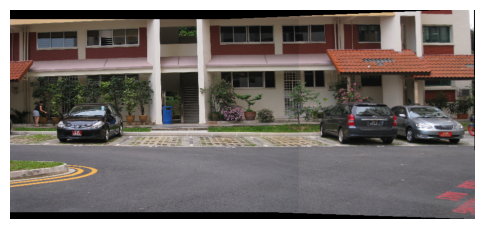

In [59]:
# stitiching image3 and image4 
src_pts, dst_pts, matching_result = get_src_dst_points(image3, image4)
show_image(BGR2RGB(matching_result), w=6, h=3)
best_H = ransac_homography(src_pts, dst_pts, n_iter=10000, threshold=0.5)
aligned_image_2 = get_transformed_images(image3, image4, best_H, focus=1, blend=False)
aligned_image_2 = remove_black_background(BGR2RGB(aligned_image_2))
show_image(aligned_image_2, w=6, h=3)

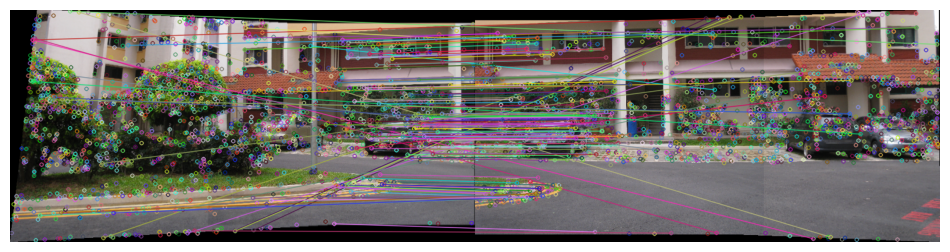

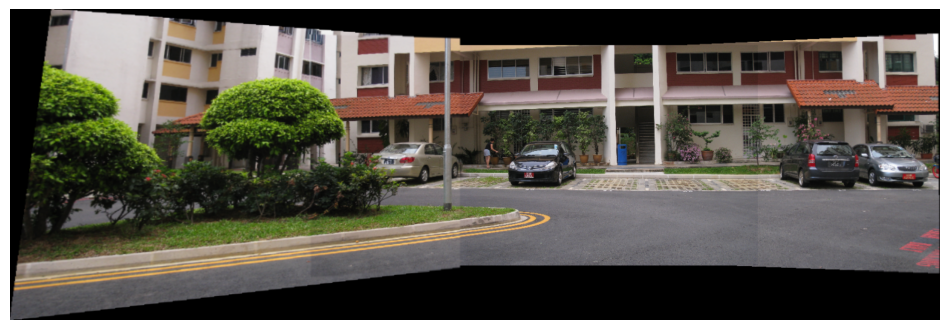

True

In [61]:
# stitiching aligned_image_1 and aligned_image_2
aligned_1 = BGR2RGB(aligned_image_1)
aligned_2 = BGR2RGB(aligned_image_2)
aligned_1 = cv2.resize(aligned_1, (800, 400))
aligned_2 = cv2.resize(aligned_2, (800, 400))

src_pts, dst_pts, matching_result = get_src_dst_points(aligned_1, aligned_2)
show_image(BGR2RGB(matching_result), w=12, h=6)
best_H = ransac_homography(src_pts, dst_pts, n_iter=10000, threshold=0.5)
aligned_image_3 = get_transformed_images(aligned_1, aligned_2, best_H, focus=2)
aligned_image_3 = remove_black_background(BGR2RGB(aligned_image_3))
show_image(aligned_image_3, w=12, h=6)

# saving the stitched image
aligned_image_3 = BGR2RGB(aligned_image_3)
cv2.imwrite('Results/scene1/scene1.jpg', aligned_image_3)

#### Scene 2

In [62]:
# creating folder for scene1
if not os.path.exists('Results/scene2'):
    os.makedirs('Results/scene2')

# operning the images
image1 = open_resize('Dataset/scene2/I21.jpg', 600, 400)
image2 = open_resize('Dataset/scene2/I22.jpg', 600, 400)
image3 = open_resize('Dataset/scene2/I23.jpg', 600, 400)
image4 = open_resize('Dataset/scene2/I24.jpg', 600, 400)

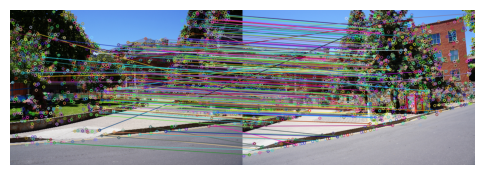

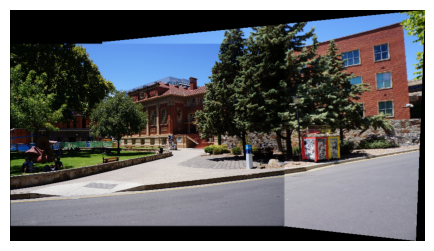

In [63]:
# stitiching image1 and image2
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
show_image(BGR2RGB(matching_result), w=6, h=3)
best_H = ransac_homography(src_pts, dst_pts, n_iter=1000, threshold=0.5)
aligned_image_1 = get_transformed_images(image1, image2, best_H, focus=1, blend=True)
aligned_image_1 = remove_black_background(BGR2RGB(aligned_image_1))
show_image(aligned_image_1, w=6, h=3)

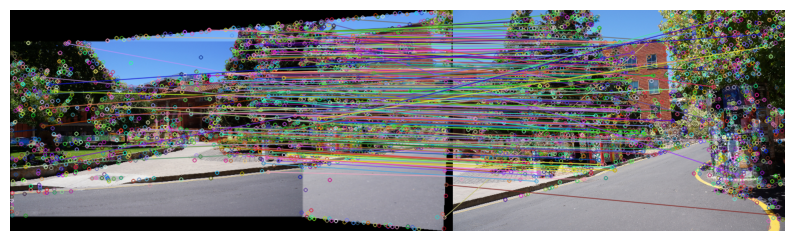

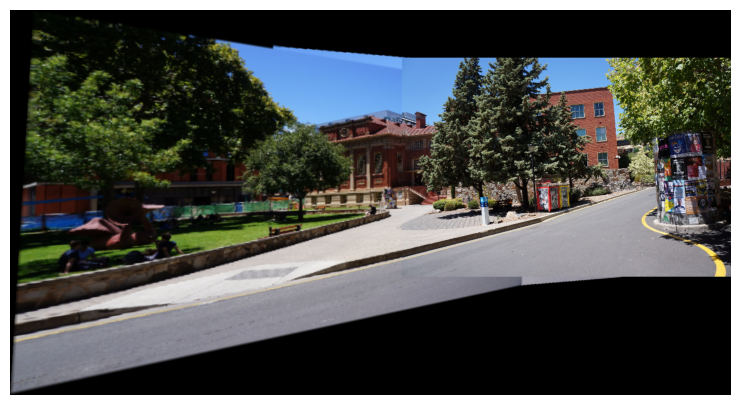

In [64]:
# stitiching aligned_image_1 and image3
aligned_1 = BGR2RGB(aligned_image_1)
aligned_1 = cv2.resize(aligned_1, (800, 400))

src_pts, dst_pts, matching_result = get_src_dst_points(aligned_1, image3)
show_image(BGR2RGB(matching_result), w=10, h=5)
best_H = ransac_homography(src_pts, dst_pts, n_iter=10000, threshold=5)
aligned_image_2 = get_transformed_images(aligned_1, image3, best_H, focus=2, blend=False)
aligned_image_2 = remove_black_background(BGR2RGB(aligned_image_2))
show_image(aligned_image_2, w=10, h=5)

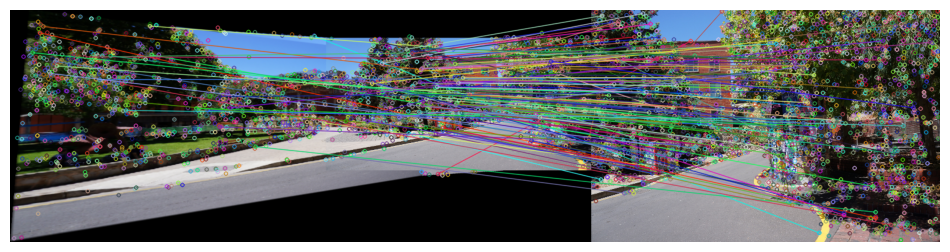

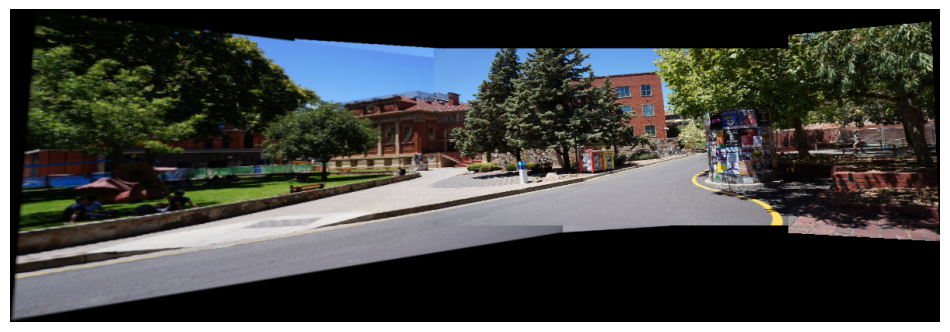

True

In [66]:
# stitiching aligned_image_2 and image4
aligned_2 = BGR2RGB(aligned_image_2)
aligned_2 = cv2.resize(aligned_2, (1000, 400))

src_pts, dst_pts, matching_result = get_src_dst_points(aligned_2, image4)
show_image(BGR2RGB(matching_result), w=12, h=6)
best_H = ransac_homography(src_pts, dst_pts, n_iter=10000, threshold=0.5)
aligned_image_3 = get_transformed_images(aligned_2, image4, best_H, focus=1, blend=True)
aligned_image_3 = remove_black_background(BGR2RGB(aligned_image_3))
show_image(aligned_image_3, w=12, h=6)

# saving the stitched image
aligned_image_3 = BGR2RGB(aligned_image_3)
cv2.imwrite('Results/scene2/scene2.jpg', aligned_image_3)

#### Scene 3

In [67]:
# creating folder for scene1
if not os.path.exists('Results/scene3'):
    os.makedirs('Results/scene3')

# operning the images
image1 = open_resize('Dataset/scene3/I31.jpg', 600, 400)
image2 = open_resize('Dataset/scene3/I32.jpg', 600, 400)
image3 = open_resize('Dataset/scene3/I33.jpg', 600, 400)
image4 = open_resize('Dataset/scene3/I34.jpg', 600, 400)

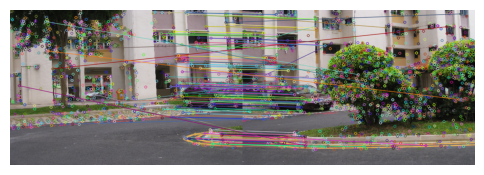

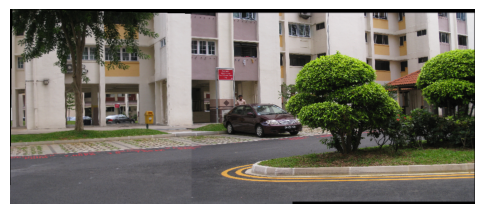

In [77]:
# stitiching image1 and image2
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
show_image(BGR2RGB(matching_result), w=6, h=3)
best_H = ransac_homography(src_pts, dst_pts, n_iter=1000, threshold=0.5)
aligned_image_1 = get_transformed_images(image1, image2, best_H, focus=2, blend=True)
aligned_image_1 = remove_black_background(BGR2RGB(aligned_image_1))
show_image(aligned_image_1, w=6, h=3)

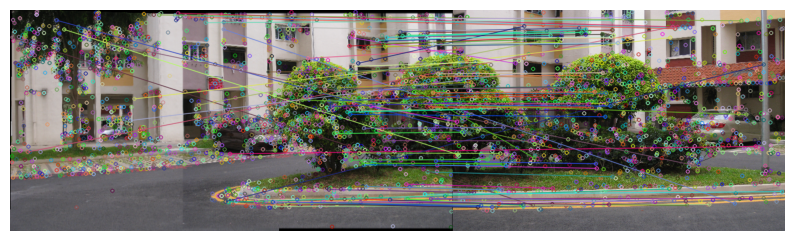

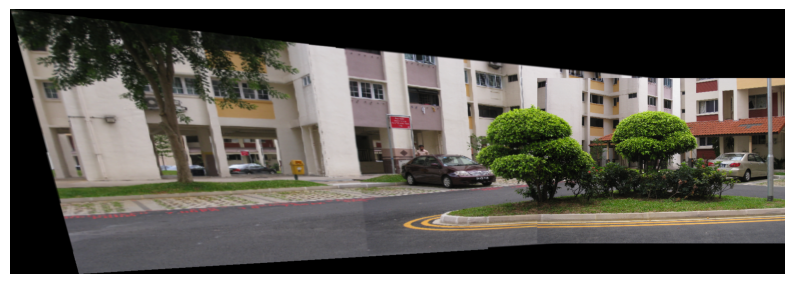

In [80]:
# stitching aligned_image_1 and image3
aligned_1 = BGR2RGB(aligned_image_1)
aligned_1 = cv2.resize(aligned_1, (800, 400))

src_pts, dst_pts, matching_result = get_src_dst_points(aligned_1, image3)
show_image(BGR2RGB(matching_result), w=10, h=5)
best_H = ransac_homography(src_pts, dst_pts, n_iter=10000, threshold=0.5)
aligned_image_2 = get_transformed_images(aligned_1, image3, best_H, focus=2, blend=False)
aligned_image_2 = remove_black_background(BGR2RGB(aligned_image_2))
show_image(aligned_image_2, w=10, h=5)

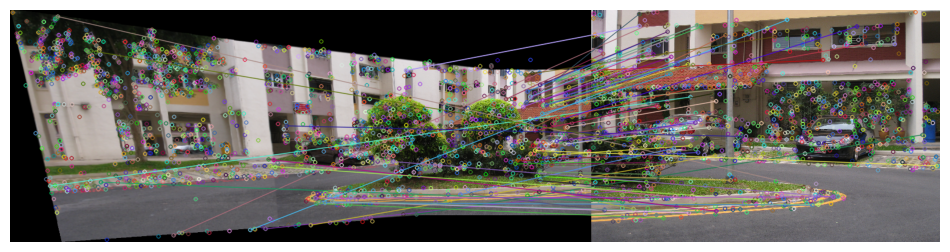

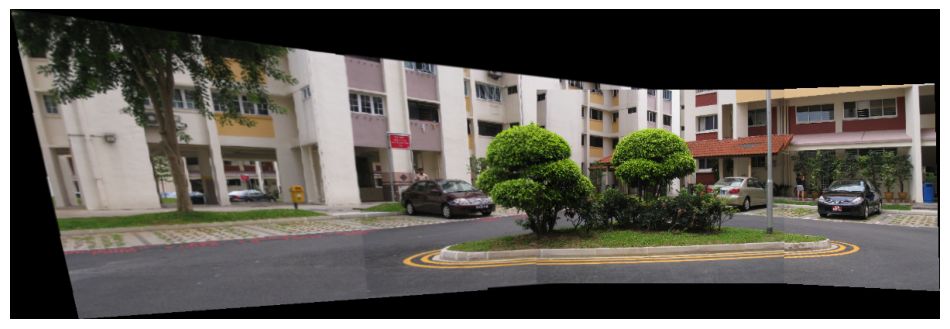

True

In [82]:
# stitching aligned_image_2 and image4
aligned_2 = BGR2RGB(aligned_image_2)
aligned_2 = cv2.resize(aligned_2, (1000, 400))

src_pts, dst_pts, matching_result = get_src_dst_points(aligned_2, image4)
show_image(BGR2RGB(matching_result), w=12, h=6)
best_H = ransac_homography(src_pts, dst_pts, n_iter=10000, threshold=0.5)
aligned_image_3 = get_transformed_images(aligned_2, image4, best_H, focus=1, blend=False)
aligned_image_3 = remove_black_background(BGR2RGB(aligned_image_3))
show_image(aligned_image_3, w=12, h=6)

# saving the stitched image
aligned_image_3 = BGR2RGB(aligned_image_3)
cv2.imwrite('Results/scene3/scene3.jpg', aligned_image_3)

#### Scene 4

In [92]:
# creating folder for scene1
if not os.path.exists('Results/scene4'):
    os.makedirs('Results/scene4')

# operning the images
image1 = open_resize('Dataset/scene4/I41.jpg', 600, 400)
image2 = open_resize('Dataset/scene4/I42.jpg', 600, 400)

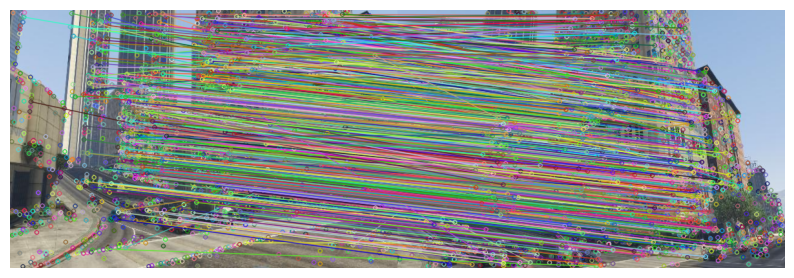

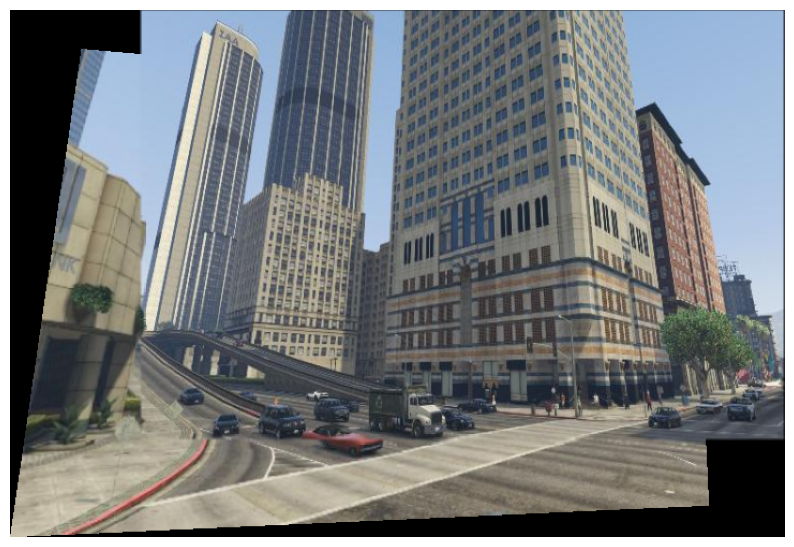

True

In [93]:
# stitiching image1 and image2
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
show_image(BGR2RGB(matching_result), w=10, h=5)
best_H = ransac_homography(src_pts, dst_pts, n_iter=10000, threshold=0.5)
aligned_image_1 = get_transformed_images(image1, image2, best_H, focus=2, blend=True)
aligned_image_1 = remove_black_background(BGR2RGB(aligned_image_1))
show_image(aligned_image_1, w=10, h=10)

# saving the stitched image
aligned_image_1 = BGR2RGB(aligned_image_1)
cv2.imwrite('Results/scene4/scene4.jpg', aligned_image_1)

#### Scene 5

In [94]:
# creating folder for scene1
if not os.path.exists('Results/scene5'):
    os.makedirs('Results/scene5')

# operning the images
image1 = open_resize('Dataset/scene5/I51.jpg', 600, 400)
image2 = open_resize('Dataset/scene5/I52.jpg', 600, 400)

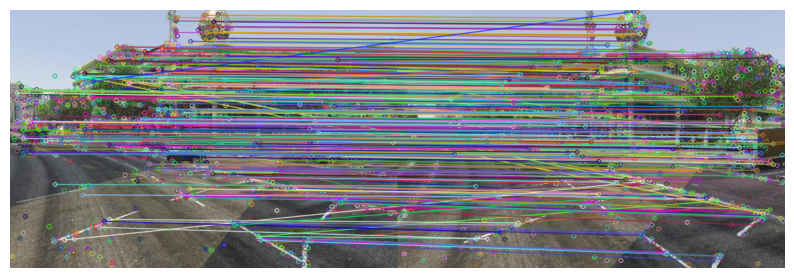

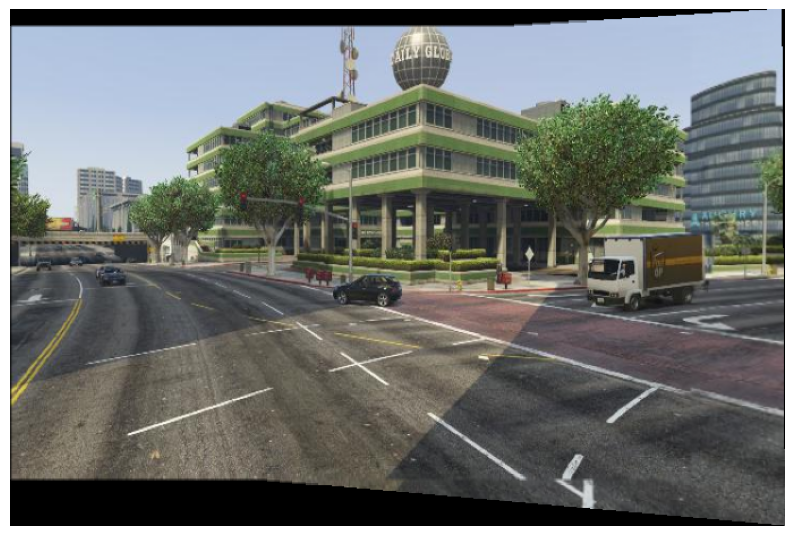

True

In [96]:
# stitiching image1 and image2
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
show_image(BGR2RGB(matching_result), w=10, h=5)
best_H = ransac_homography(src_pts, dst_pts, n_iter=10000, threshold=0.5)
aligned_image_1 = get_transformed_images(image1, image2, best_H, focus=2, blend=True)
aligned_image_1 = remove_black_background(BGR2RGB(aligned_image_1))
show_image(aligned_image_1, w=10, h=8)

# saving the stitched image
aligned_image_1 = BGR2RGB(aligned_image_1)
cv2.imwrite('Results/scene5/scene5.jpg', aligned_image_1)

#### Scene 6

In [97]:
# creating folder for scene1
if not os.path.exists('Results/scene6'):
    os.makedirs('Results/scene6')

# operning the images
image1 = open_resize('Dataset/scene6/I61.jpg', 600, 400)
image2 = open_resize('Dataset/scene6/I62.jpg', 600, 400)

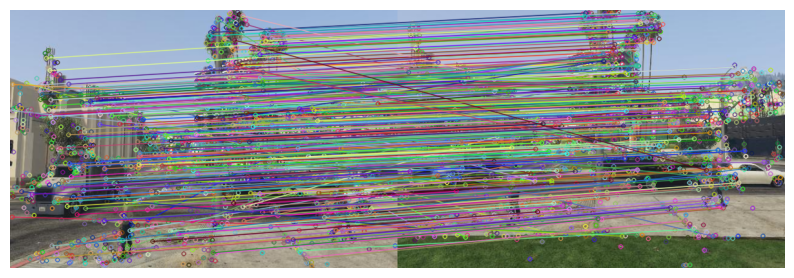

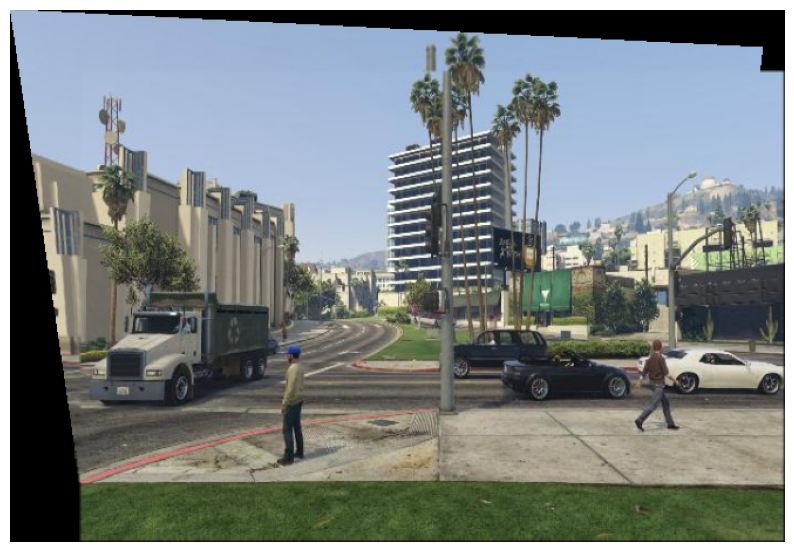

True

In [99]:
# stitiching image1 and image2
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
show_image(BGR2RGB(matching_result), w=10, h=5)
best_H = ransac_homography(src_pts, dst_pts, n_iter=10000, threshold=5)
aligned_image_1 = get_transformed_images(image1, image2, best_H, focus=2, blend=True)
aligned_image_1 = remove_black_background(BGR2RGB(aligned_image_1))
show_image(aligned_image_1, w=10, h=8)

# saving the stitched image
aligned_image_1 = BGR2RGB(aligned_image_1)
cv2.imwrite('Results/scene6/scene6.jpg', aligned_image_1)

### `Step 4` Stitch the images used as input in step (3) using in-built command for homography estimation and compare it with the panorama obtained in step (3).

##### Helper function

In [1]:
# function for finding the best homography matrix using cv2 library
def cv2_get_RANSAC_Homography(src_pts, dst_pts, threshold=5):
    H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, threshold) # find the best homography matrix
    return H # return the best homography matrix

#### Scene 1

In [16]:
# operning the images
image1 = open_resize('Dataset/scene1/I11.jpg', 600, 400)
image2 = open_resize('Dataset/scene1/I12.jpg', 600, 400)
image3 = open_resize('Dataset/scene1/I13.jpg', 600, 400)
image4 = open_resize('Dataset/scene1/I14.jpg', 600, 400)

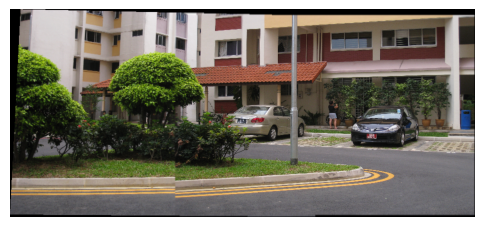

In [17]:
# stitiching image1 and image2
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
best_H = cv2_get_RANSAC_Homography(src_pts, dst_pts, threshold=5)
aligned_image_1 = get_transformed_images(image1, image2, best_H, focus=2, blend=True)
aligned_image_1 = remove_black_background(BGR2RGB(aligned_image_1))
show_image(aligned_image_1, w=6, h=3)

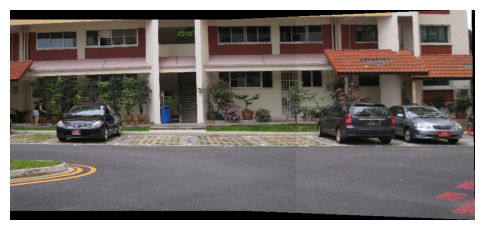

In [18]:
# stitiching image3 and image4 
src_pts, dst_pts, matching_result = get_src_dst_points(image3, image4)
best_H = cv2_get_RANSAC_Homography(src_pts, dst_pts, threshold=0.5)
aligned_image_2 = get_transformed_images(image3, image4, best_H, focus=1, blend=False)
aligned_image_2 = remove_black_background(BGR2RGB(aligned_image_2))
show_image(aligned_image_2, w=6, h=3)

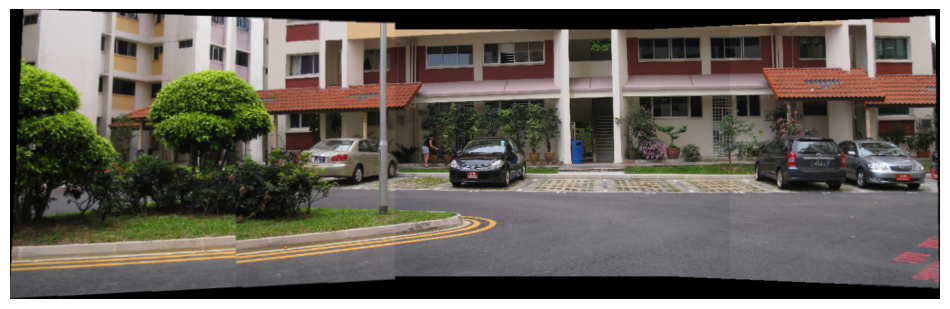

True

In [19]:
# stitiching aligned_image_1 and aligned_image_2
aligned_1 = BGR2RGB(aligned_image_1)
aligned_2 = BGR2RGB(aligned_image_2)
aligned_1 = cv2.resize(aligned_1, (800, 400))
aligned_2 = cv2.resize(aligned_2, (800, 400))

src_pts, dst_pts, matching_result = get_src_dst_points(aligned_1, aligned_2)
best_H = cv2_get_RANSAC_Homography(src_pts, dst_pts, threshold=0.5)
aligned_image_3 = get_transformed_images(aligned_1, aligned_2, best_H, focus=2)
aligned_image_3 = remove_black_background(BGR2RGB(aligned_image_3))
show_image(aligned_image_3, w=12, h=6)

# saving the stitched image
aligned_image_3 = BGR2RGB(aligned_image_3)
cv2.imwrite('Results/scene1/scene1_cv2.jpg', aligned_image_3)

Comparing the results of the two methods

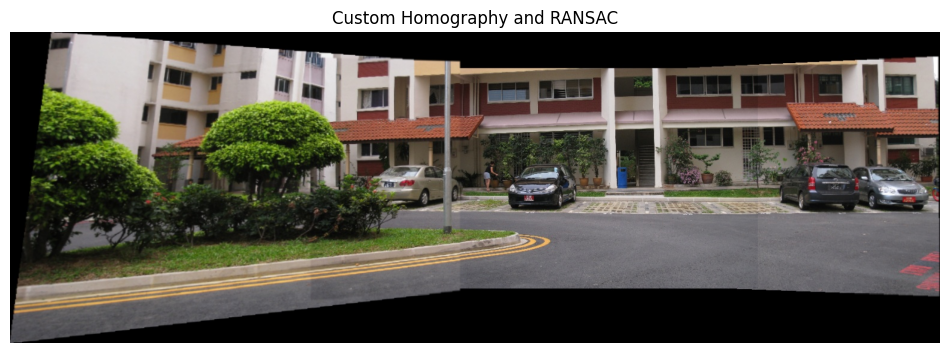

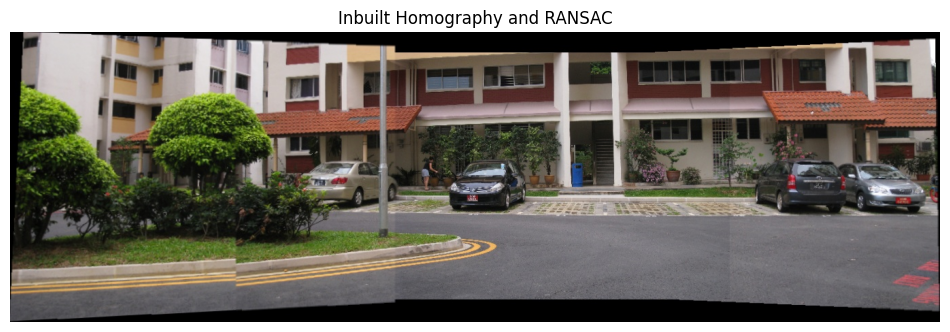

In [24]:
custom = cv2.imread('Results/scene1/scene1.jpg')
show_image(BGR2RGB(custom), w=12, h=6, title='Custom Homography and RANSAC')

inbuilt = cv2.imread('Results/scene1/scene1_cv2.jpg')
show_image(BGR2RGB(inbuilt), w=12, h=6, title='Inbuilt Homography and RANSAC')

**Inference**
<hr>

The image obtained through a custom implementation of homography computation and RANSAC looks similar to the image obtained through the built-in function for homography estimation.

#### Scene 2

In [43]:
# operning the images
image1 = open_resize('Dataset/scene2/I21.jpg', 600, 400)
image2 = open_resize('Dataset/scene2/I22.jpg', 600, 400)
image3 = open_resize('Dataset/scene2/I23.jpg', 600, 400)
image4 = open_resize('Dataset/scene2/I24.jpg', 600, 400)

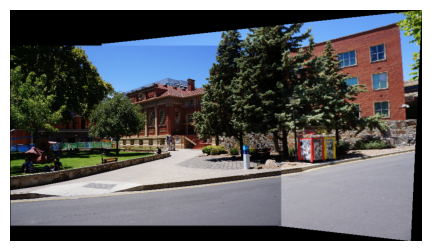

In [45]:
# stitiching image1 and image2
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
best_H = cv2_get_RANSAC_Homography(src_pts, dst_pts, threshold=0.5)
aligned_image_1 = get_transformed_images(image1, image2, best_H, focus=1, blend=True)
aligned_image_1 = remove_black_background(BGR2RGB(aligned_image_1))
show_image(aligned_image_1, w=6, h=3)

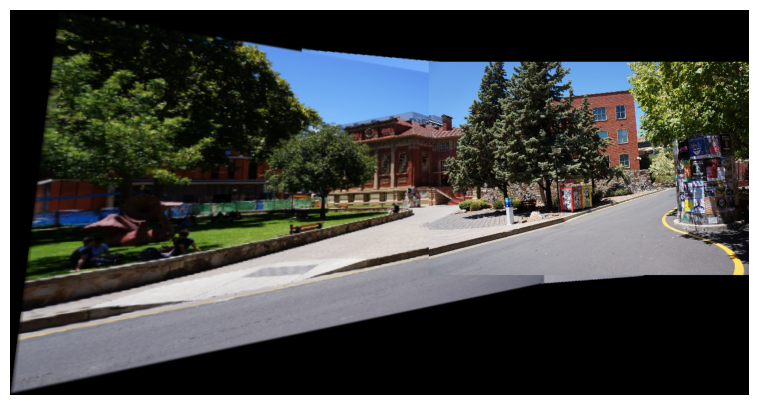

In [46]:
# stitiching aligned_image_1 and image3
aligned_1 = BGR2RGB(aligned_image_1)
aligned_1 = cv2.resize(aligned_1, (800, 400))

src_pts, dst_pts, matching_result = get_src_dst_points(aligned_1, image3)
best_H = cv2_get_RANSAC_Homography(src_pts, dst_pts, threshold=5)
aligned_image_2 = get_transformed_images(aligned_1, image3, best_H, focus=2, blend=False)
aligned_image_2 = remove_black_background(BGR2RGB(aligned_image_2))
show_image(aligned_image_2, w=10, h=5)

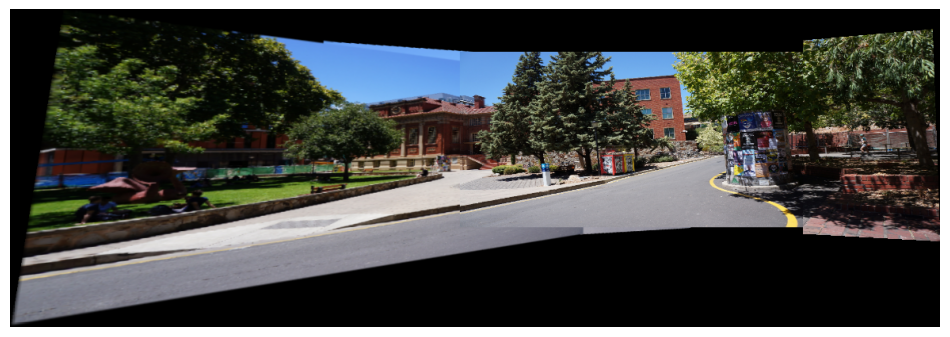

True

In [47]:
# stitiching aligned_image_2 and image4
aligned_2 = BGR2RGB(aligned_image_2)
aligned_2 = cv2.resize(aligned_2, (1000, 400))

src_pts, dst_pts, matching_result = get_src_dst_points(aligned_2, image4)
best_H = cv2_get_RANSAC_Homography(src_pts, dst_pts, threshold=0.5)
aligned_image_3 = get_transformed_images(aligned_2, image4, best_H, focus=1, blend=True)
aligned_image_3 = remove_black_background(BGR2RGB(aligned_image_3))
show_image(aligned_image_3, w=12, h=6)

# saving the stitched image
aligned_image_3 = BGR2RGB(aligned_image_3)
cv2.imwrite('Results/scene2/scene2_cv2.jpg', aligned_image_3)

Comparing the results of the two methods

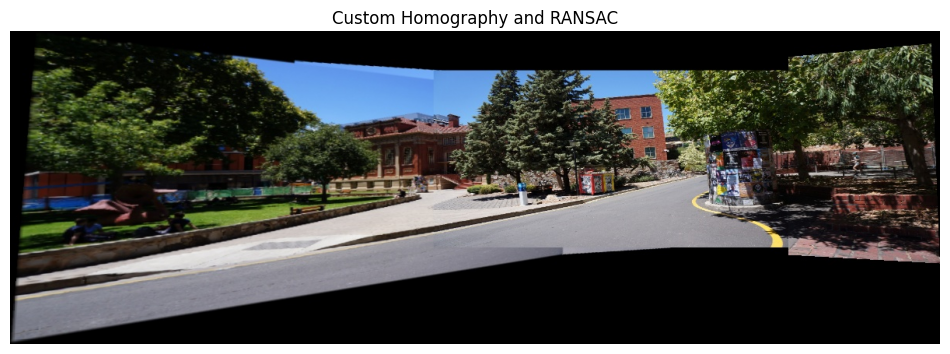

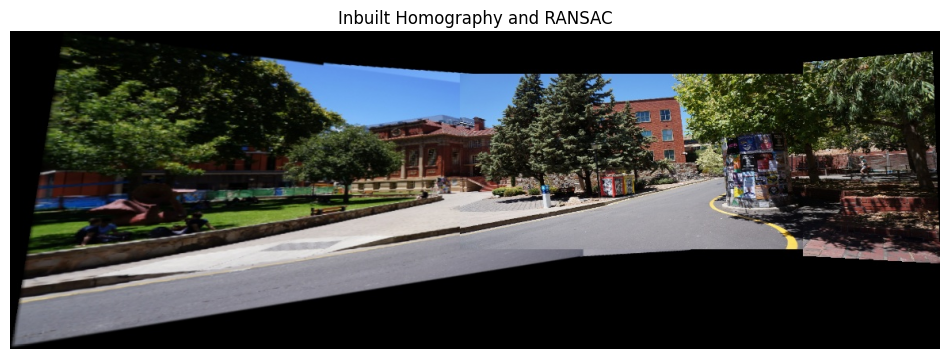

In [55]:
custom = cv2.imread('Results/scene2/scene2.jpg')
show_image(BGR2RGB(custom), w=12, h=6, title='Custom Homography and RANSAC')

inbuilt = cv2.imread('Results/scene2/scene2_cv2.jpg')
show_image(BGR2RGB(inbuilt), w=12, h=6, title='Inbuilt Homography and RANSAC')

**Inference**
<hr>

The image obtained through a custom implementation of homography computation and RANSAC looks similar to the image obtained through the built-in function for homography estimation.

#### Scene 3

In [48]:
# operning the images
image1 = open_resize('Dataset/scene3/I31.jpg', 600, 400)
image2 = open_resize('Dataset/scene3/I32.jpg', 600, 400)
image3 = open_resize('Dataset/scene3/I33.jpg', 600, 400)
image4 = open_resize('Dataset/scene3/I34.jpg', 600, 400)

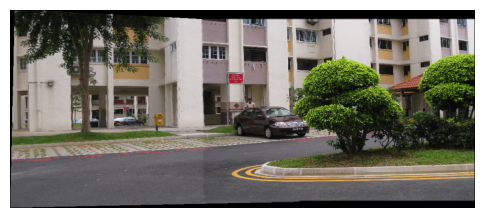

In [49]:
# stitiching image1 and image2
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
best_H = cv2_get_RANSAC_Homography(src_pts, dst_pts, threshold=0.5)
aligned_image_1 = get_transformed_images(image1, image2, best_H, focus=2, blend=True)
aligned_image_1 = remove_black_background(BGR2RGB(aligned_image_1))
show_image(aligned_image_1, w=6, h=3)

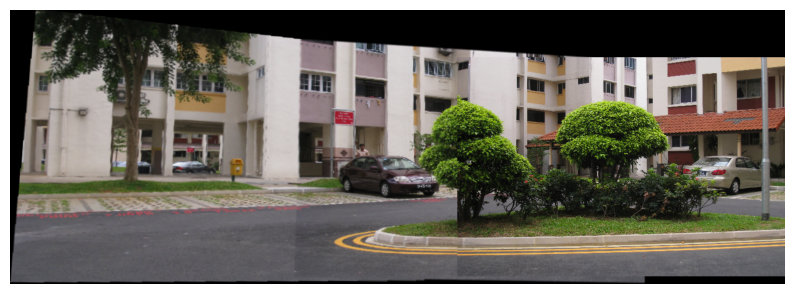

In [53]:
# stitching aligned_image_1 and image3
aligned_1 = BGR2RGB(aligned_image_1)
aligned_1 = cv2.resize(aligned_1, (800, 400))

src_pts, dst_pts, matching_result = get_src_dst_points(aligned_1, image3)
best_H = cv2_get_RANSAC_Homography(src_pts, dst_pts, threshold=2)
aligned_image_2 = get_transformed_images(aligned_1, image3, best_H, focus=2, blend=False)
aligned_image_2 = remove_black_background(BGR2RGB(aligned_image_2))
show_image(aligned_image_2, w=10, h=5)

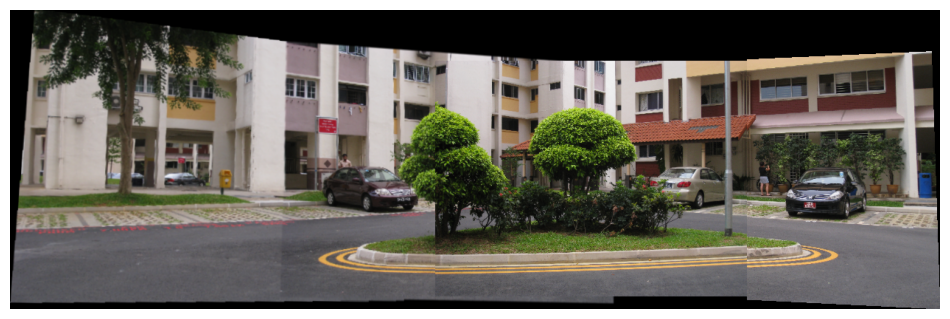

True

In [54]:
# stitching aligned_image_2 and image4
aligned_2 = BGR2RGB(aligned_image_2)
aligned_2 = cv2.resize(aligned_2, (1000, 400))

src_pts, dst_pts, matching_result = get_src_dst_points(aligned_2, image4)
best_H = cv2_get_RANSAC_Homography(src_pts, dst_pts, threshold=0.5)
aligned_image_3 = get_transformed_images(aligned_2, image4, best_H, focus=1, blend=False)
aligned_image_3 = remove_black_background(BGR2RGB(aligned_image_3))
show_image(aligned_image_3, w=12, h=6)

# saving the stitched image
aligned_image_3 = BGR2RGB(aligned_image_3)
cv2.imwrite('Results/scene3/scene3_cv2.jpg', aligned_image_3)

Comparing the results of the two methods

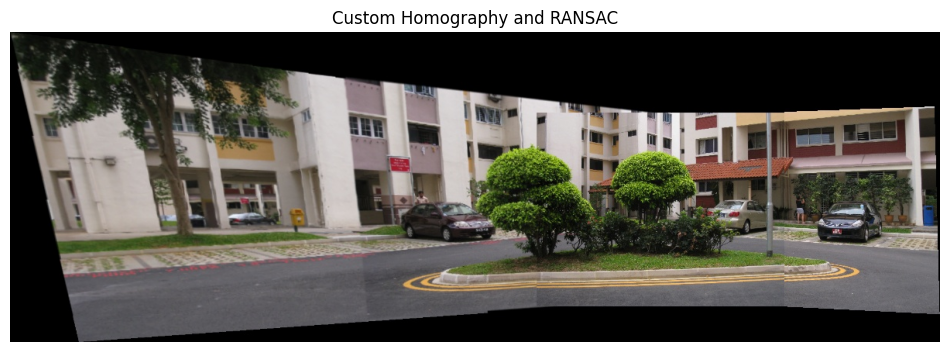

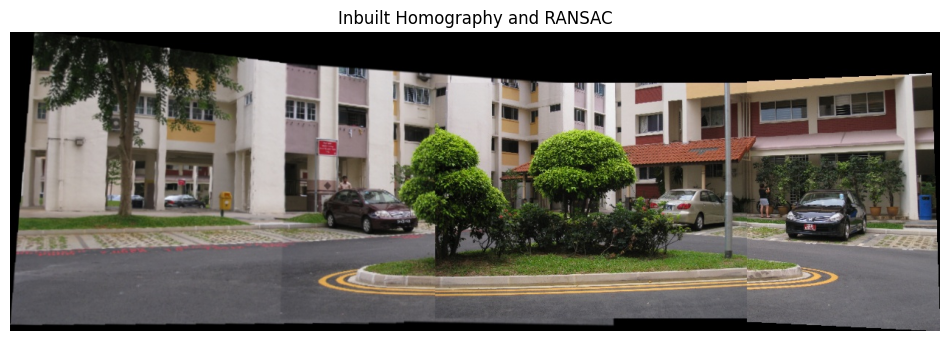

In [56]:
custom = cv2.imread('Results/scene3/scene3.jpg')
show_image(BGR2RGB(custom), w=12, h=6, title='Custom Homography and RANSAC')

inbuilt = cv2.imread('Results/scene3/scene3_cv2.jpg')
show_image(BGR2RGB(inbuilt), w=12, h=6, title='Inbuilt Homography and RANSAC')

**Inference**
<hr>

The image obtained through a custom implementation of homography computation and RANSAC looks similar to the image obtained through the built-in function for homography estimation.

#### Scene 4

In [60]:
# operning the images
image1 = open_resize('Dataset/scene4/I41.jpg', 600, 400)
image2 = open_resize('Dataset/scene4/I42.jpg', 600, 400)

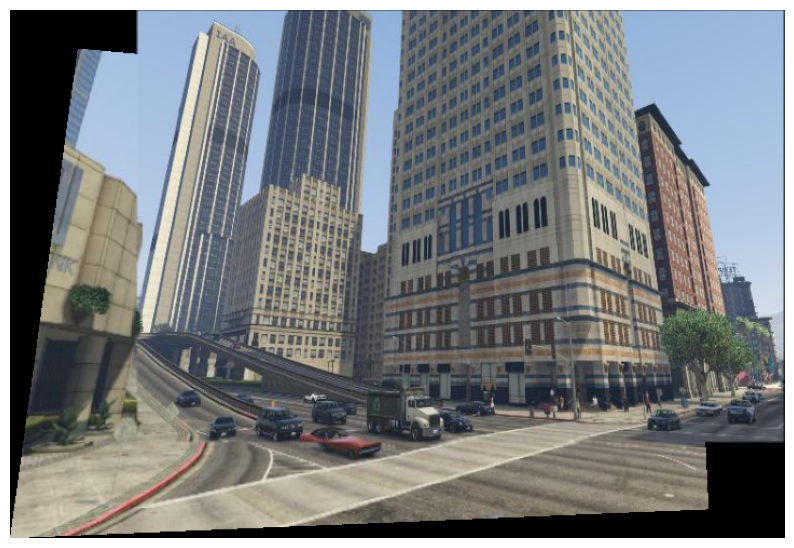

True

In [58]:
# stitiching image1 and image2
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
best_H = cv2_get_RANSAC_Homography(src_pts, dst_pts, threshold=0.5)
aligned_image_1 = get_transformed_images(image1, image2, best_H, focus=2, blend=True)
aligned_image_1 = remove_black_background(BGR2RGB(aligned_image_1))
show_image(aligned_image_1, w=10, h=10)

# saving the stitched image
aligned_image_1 = BGR2RGB(aligned_image_1)
cv2.imwrite('Results/scene4/scene4_cv2.jpg', aligned_image_1)

Comparing the results of the two methods

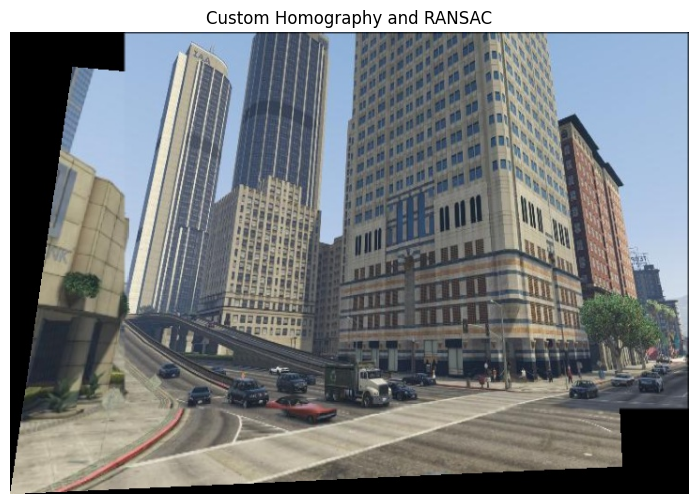

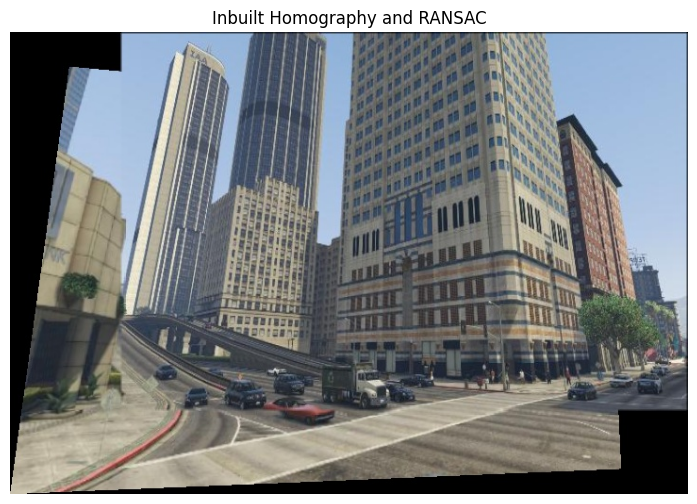

In [59]:
custom = cv2.imread('Results/scene4/scene4.jpg')
show_image(BGR2RGB(custom), w=12, h=6, title='Custom Homography and RANSAC')

inbuilt = cv2.imread('Results/scene4/scene4_cv2.jpg')
show_image(BGR2RGB(inbuilt), w=12, h=6, title='Inbuilt Homography and RANSAC')

**Inference**
<hr>

The image obtained through a custom implementation of homography computation and RANSAC looks similar to the image obtained through the built-in function for homography estimation.

#### Scene 5

In [61]:
# operning the images
image1 = open_resize('Dataset/scene5/I51.jpg', 600, 400)
image2 = open_resize('Dataset/scene5/I52.jpg', 600, 400)

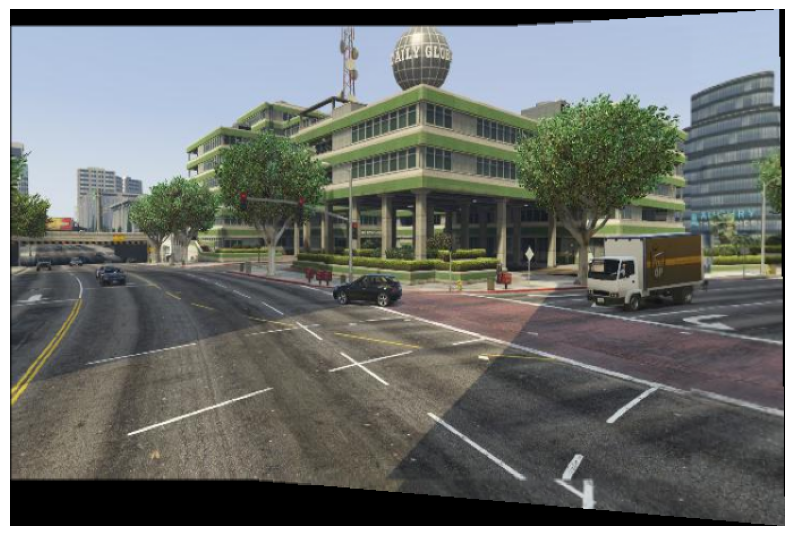

True

In [62]:
# stitiching image1 and image2
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
best_H = cv2_get_RANSAC_Homography(src_pts, dst_pts, threshold=0.5)
aligned_image_1 = get_transformed_images(image1, image2, best_H, focus=2, blend=True)
aligned_image_1 = remove_black_background(BGR2RGB(aligned_image_1))
show_image(aligned_image_1, w=10, h=8)

# saving the stitched image
aligned_image_1 = BGR2RGB(aligned_image_1)
cv2.imwrite('Results/scene5/scene5_cv2.jpg', aligned_image_1)

Comparing the results of the two methods

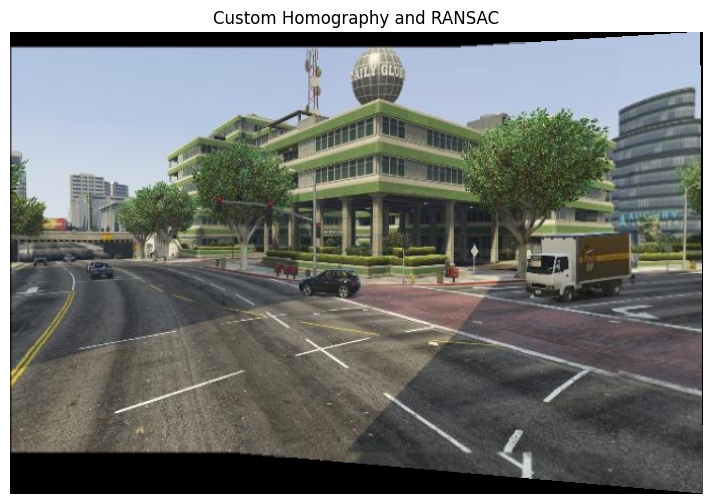

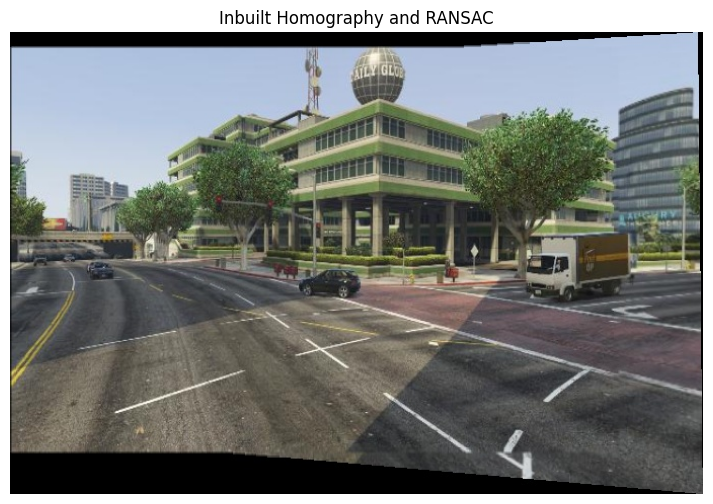

In [63]:
custom = cv2.imread('Results/scene5/scene5.jpg')
show_image(BGR2RGB(custom), w=12, h=6, title='Custom Homography and RANSAC')

inbuilt = cv2.imread('Results/scene5/scene5_cv2.jpg')
show_image(BGR2RGB(inbuilt), w=12, h=6, title='Inbuilt Homography and RANSAC')

**Inference**
<hr>

The image obtained through a custom implementation of homography computation and RANSAC looks similar to the image obtained through the built-in function for homography estimation.

#### Scene 6

In [64]:
# operning the images
image1 = open_resize('Dataset/scene6/I61.jpg', 600, 400)
image2 = open_resize('Dataset/scene6/I62.jpg', 600, 400)

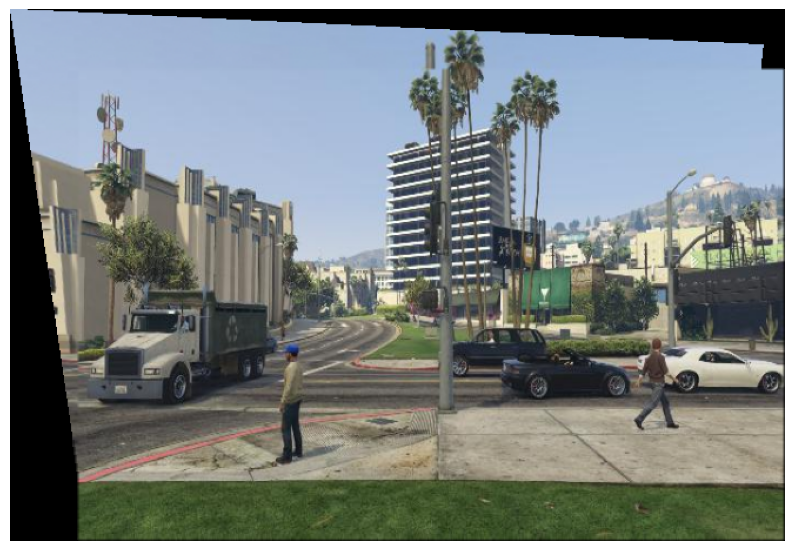

True

In [65]:
# stitiching image1 and image2
src_pts, dst_pts, matching_result = get_src_dst_points(image1, image2)
best_H = cv2_get_RANSAC_Homography(src_pts, dst_pts, threshold=5)
aligned_image_1 = get_transformed_images(image1, image2, best_H, focus=2, blend=True)
aligned_image_1 = remove_black_background(BGR2RGB(aligned_image_1))
show_image(aligned_image_1, w=10, h=8)

# saving the stitched image
aligned_image_1 = BGR2RGB(aligned_image_1)
cv2.imwrite('Results/scene6/scene6_cv2.jpg', aligned_image_1)

Comparing the results of the two methods

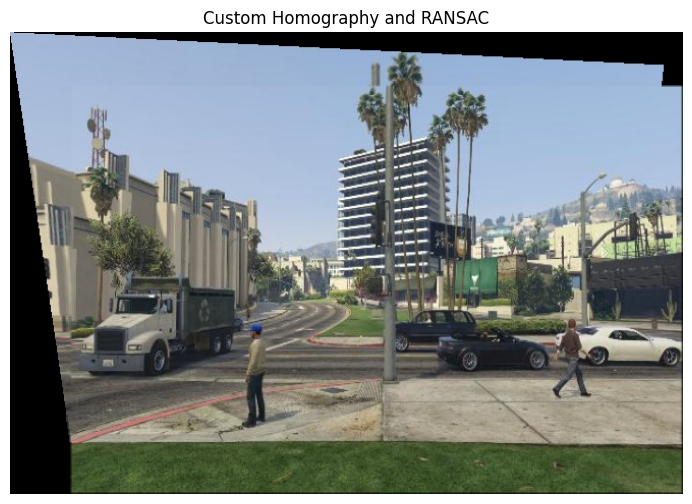

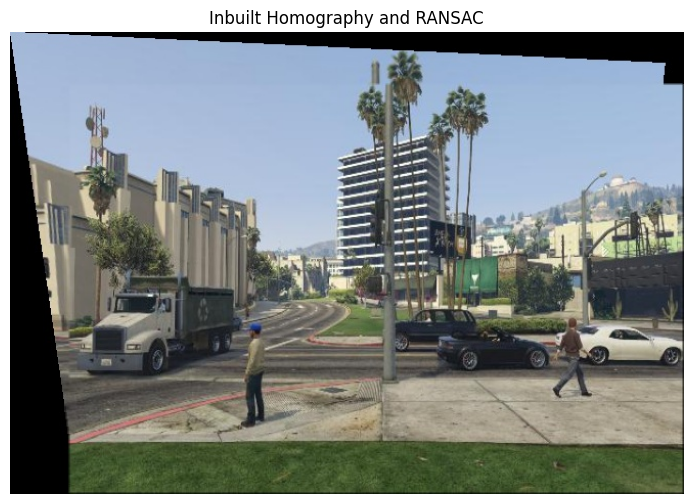

In [66]:
custom = cv2.imread('Results/scene6/scene6.jpg')
show_image(BGR2RGB(custom), w=12, h=6, title='Custom Homography and RANSAC')

inbuilt = cv2.imread('Results/scene6/scene6_cv2.jpg')
show_image(BGR2RGB(inbuilt), w=12, h=6, title='Inbuilt Homography and RANSAC')

**Inference**
<hr>

The image obtained through a custom implementation of homography computation and RANSAC looks similar to the image obtained through the built-in function for homography estimation.

### `References`

- Image stitching, https://en.wikipedia.org/wiki/Image_stitching
- Perspective Transformation, https://www.tutorialspoint.com/dip/perspective_transformation.htm
- First Principles of Computer Vision, Columbia Engineering, https://fpcv.cs.columbia.edu
- Feature Based Panoramic Image Stitching, https://in.mathworks.com/help/vision/ug/feature-based-panoramic-image-stitching.html